# Equity Data - Feature Engineering

## Imports & Settings

In [1]:
import warnings
warnings.filterwarnings('ignore')

In [2]:
%matplotlib inline

from pathlib import Path

import numpy as np
import pandas as pd
import talib

import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
sns.set_style('white')

In [4]:
idx = pd.IndexSlice

## Get Data

### Stooq Japanese Equity data 2014-2019

In [5]:
DATA_DIR = Path('.', 'data')

In [6]:
prices = pd.read_hdf(DATA_DIR / 'assets.h5', 'merval/prices')

In [7]:
prices.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 186798 entries, (Timestamp('2010-01-04 00:00:00'), 'ALUA.BA') to (Timestamp('2023-12-29 00:00:00'), 'YPFD.BA')
Data columns (total 12 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   open         186798 non-null  float64
 1   high         186798 non-null  float64
 2   low          186798 non-null  float64
 3   close        186798 non-null  float64
 4   volume       186798 non-null  float64
 5   ex-dividend  186798 non-null  int64  
 6   split_ratio  186798 non-null  int64  
 7   adj_open     186798 non-null  float64
 8   adj_high     186798 non-null  float64
 9   adj_low      186798 non-null  float64
 10  adj_close    186798 non-null  float64
 11  adj_volume   186798 non-null  float64
dtypes: float64(10), int64(2)
memory usage: 17.8+ MB


In [8]:
before = len(prices.index.unique('ticker').unique())

### Remove symbols with missing values

In [9]:
prices = (prices.unstack('ticker')
        .sort_index()
        .ffill(limit=5)
        .dropna(axis=1)
        .stack('ticker')
        .swaplevel())
prices.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 170850 entries, ('ALUA.BA', Timestamp('2010-01-04 00:00:00')) to ('YPFD.BA', Timestamp('2023-12-29 00:00:00'))
Data columns (total 12 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   open         170850 non-null  float64
 1   high         170850 non-null  float64
 2   low          170850 non-null  float64
 3   close        170850 non-null  float64
 4   volume       170850 non-null  float64
 5   ex-dividend  170850 non-null  float64
 6   split_ratio  170850 non-null  float64
 7   adj_open     170850 non-null  float64
 8   adj_high     170850 non-null  float64
 9   adj_low      170850 non-null  float64
 10  adj_close    170850 non-null  float64
 11  adj_volume   170850 non-null  float64
dtypes: float64(12)
memory usage: 16.3+ MB


In [10]:
after = len(prices.index.unique('ticker').unique())
print(f'Before: {before:,.0f} after: {after:,.0f}')

Before: 58 after: 50


### Keep most traded symbols

In [11]:
dv = prices.close.mul(prices.volume)
keep = dv.groupby('ticker').median().nlargest(1000).index.tolist()

In [12]:
prices = prices.loc[idx[keep, :], :]
prices.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 170850 entries, ('GGAL.BA', Timestamp('2010-01-04 00:00:00')) to ('VALO.BA', Timestamp('2023-12-29 00:00:00'))
Data columns (total 12 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   open         170850 non-null  float64
 1   high         170850 non-null  float64
 2   low          170850 non-null  float64
 3   close        170850 non-null  float64
 4   volume       170850 non-null  float64
 5   ex-dividend  170850 non-null  float64
 6   split_ratio  170850 non-null  float64
 7   adj_open     170850 non-null  float64
 8   adj_high     170850 non-null  float64
 9   adj_low      170850 non-null  float64
 10  adj_close    170850 non-null  float64
 11  adj_volume   170850 non-null  float64
dtypes: float64(12)
memory usage: 16.3+ MB


## Feature Engineering

### Compute period returns

In [13]:
intervals = [1, 5, 10, 21, 63]

In [38]:
returns = []
by_ticker = prices.groupby(level='ticker').close
for t in intervals:
    returns.append(by_ticker.pct_change(t).to_frame(f'ret_{t}'))
returns = pd.concat(returns, axis=1)

In [39]:
returns.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 160599 entries, ('GGAL.BA', Timestamp('2010-01-04 00:00:00')) to ('VALO.BA', Timestamp('2023-12-29 00:00:00'))
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   ret_1   160552 non-null  float64
 1   ret_5   160364 non-null  float64
 2   ret_10  160129 non-null  float64
 3   ret_21  159612 non-null  float64
 4   ret_63  157638 non-null  float64
dtypes: float64(5)
memory usage: 6.7+ MB


### Remove outliers

In [16]:
max_ret_by_sym = returns.groupby(level='ticker').max()

In [17]:
percentiles = [0.001, .005, .01, .025, .05, .1]
percentiles += [1-p for p in percentiles]
max_ret_by_sym.describe(percentiles=sorted(percentiles)[6:])

,ret_1,ret_5,ret_10,ret_21,ret_63
count,50.000000,50.000000,50.000000,50.000000,50.000000
mean,1.124484,1.405134,1.530132,1.820585,2.414632
std,2.101144,2.117828,2.134451,2.034594,1.989630
min,0.131579,0.266990,0.300000,0.298780,0.390476
50%,0.348083,0.745375,0.902552,1.171692,1.774920
90%,1.698921,1.619378,1.522220,3.120506,3.936219
95%,6.671717,7.322230,7.360040,7.654105,7.926253
97.5%,8.395785,8.671615,8.661770,8.168927,8.400046
99%,9.067203,9.282710,9.615133,8.964882,9.307742
99.5%,9.200269,9.486183,9.978298,9.327269,9.700677


In [18]:
quantiles = max_ret_by_sym.quantile(.95)
to_drop = []
for ret, q in quantiles.items():
    to_drop.extend(max_ret_by_sym[max_ret_by_sym[ret]>q].index.tolist()) 

In [19]:
to_drop = pd.Series(to_drop).value_counts()
to_drop = to_drop[to_drop > 1].index.tolist()
len(to_drop)

3

In [20]:
prices = prices.drop(to_drop, level='ticker')
prices.info(show_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 160599 entries, ('GGAL.BA', Timestamp('2010-01-04 00:00:00')) to ('VALO.BA', Timestamp('2023-12-29 00:00:00'))
Data columns (total 12 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   open         160599 non-null  float64
 1   high         160599 non-null  float64
 2   low          160599 non-null  float64
 3   close        160599 non-null  float64
 4   volume       160599 non-null  float64
 5   ex-dividend  160599 non-null  float64
 6   split_ratio  160599 non-null  float64
 7   adj_open     160599 non-null  float64
 8   adj_high     160599 non-null  float64
 9   adj_low      160599 non-null  float64
 10  adj_close    160599 non-null  float64
 11  adj_volume   160599 non-null  float64
dtypes: float64(12)
memory usage: 15.3+ MB


### Calculate relative return percentiles

In [21]:
returns = []
by_sym = prices.groupby(level='ticker').close
for t in intervals:
    ret = by_sym.pct_change(t)
    rel_perc = (ret.groupby(level='date')
             .apply(lambda x: pd.qcut(x, q=20, labels=False, duplicates='drop')))
    returns.extend([ret.to_frame(f'ret_{t}'), rel_perc.to_frame(f'ret_rel_perc_{t}')])
returns = pd.concat(returns, axis=1)

IndexError: cannot do a non-empty take from an empty axes.

In [40]:
returns = []
by_sym = prices.groupby(level='ticker').close
for t in intervals:
    ret = by_sym.pct_change(t)
    print(ret)
    rel_perc = (ret.groupby(level='date')
             .apply(lambda x: print(x)))
returns = pd.concat(returns, axis=1)

ticker   date      
GGAL.BA  2010-01-04         NaN
         2010-01-05    0.027523
         2010-01-06   -0.040179
         2010-01-07    0.018605
         2010-01-08   -0.022831
                         ...   
VALO.BA  2023-12-22    0.010022
         2023-12-26   -0.014333
         2023-12-27   -0.044743
         2023-12-28    0.051522
         2023-12-29    0.003341
Name: close, Length: 160599, dtype: float64
ticker    date      
GGAL.BA   2010-01-04   NaN
YPFD.BA   2010-01-04   NaN
PAMP.BA   2010-01-04   NaN
BMA.BA    2010-01-04   NaN
TXAR.BA   2010-01-04   NaN
BBAR.BA   2010-01-04   NaN
ALUA.BA   2010-01-04   NaN
TECO2.BA  2010-01-04   NaN
COME.BA   2010-01-04   NaN
MIRG.BA   2010-01-04   NaN
CRES.BA   2010-01-04   NaN
EDN.BA    2010-01-04   NaN
TGSU2.BA  2010-01-04   NaN
TRAN.BA   2010-01-04   NaN
IRSA.BA   2010-01-04   NaN
SAMI.BA   2010-01-04   NaN
CECO2.BA  2010-01-04   NaN
BHIP.BA   2010-01-04   NaN
CTIO.BA   2010-01-04   NaN
MOLI.BA   2010-01-04   NaN
BOLT.BA   2010-01-04   

ValueError: No objects to concatenate

### Technical Indicators

#### Percentage Price Oscillator

In [ ]:
ppo = prices.groupby(level='ticker').close.apply(talib.PPO).to_frame('PPO')

#### Normalized Average True Range

In [ ]:
natr = prices.groupby(level='ticker', group_keys=False).apply(lambda x: talib.NATR(x.high, x.low, x.close)).to_frame('NATR')

#### Relative Strength Indicator

In [ ]:
rsi = prices.groupby(level='ticker').close.apply(talib.RSI).to_frame('RSI')

#### Bollinger Bands

In [ ]:
def get_bollinger(x):
    u, m, l = talib.BBANDS(x)
    return pd.DataFrame({'u': u, 'm': m, 'l': l})

In [ ]:
bbands = prices.groupby(level='ticker').close.apply(get_bollinger)

### Combine Features

In [ ]:
data = pd.concat([prices, returns, ppo, natr, rsi, bbands], axis=1)

In [ ]:
data['bbl'] = data.close.div(data.l)
data['bbu'] = data.u.div(data.close)
data = data.drop(['u', 'm', 'l'], axis=1)

In [ ]:
data.bbu.corr(data.bbl, method='spearman')

-0.1598831761711913

### Plot Indicators for randomly sample ticker

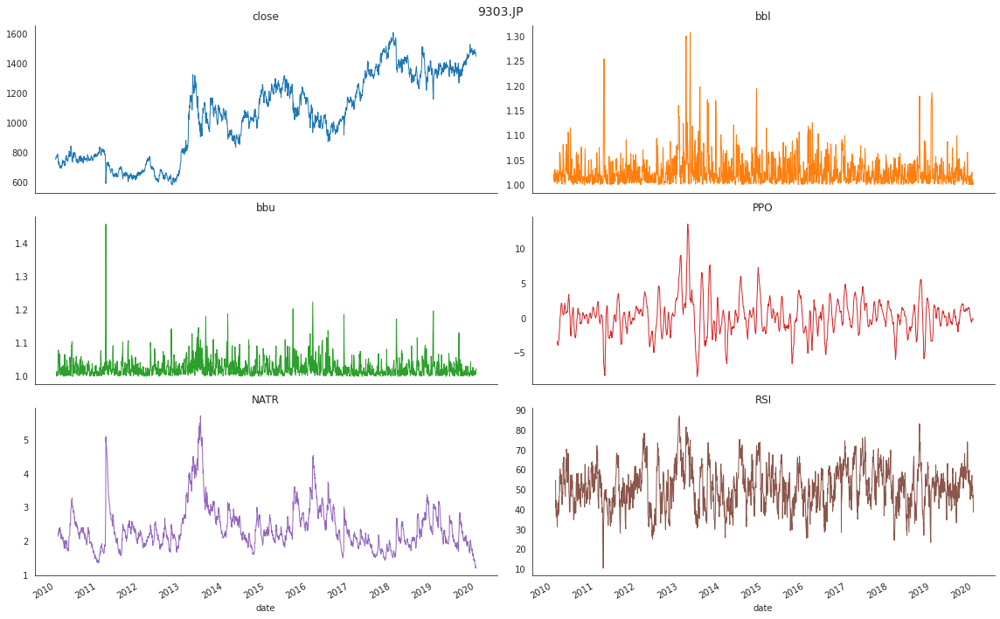

In [ ]:
indicators = ['close', 'bbl', 'bbu', 'PPO', 'NATR', 'RSI']
ticker = np.random.choice(data.index.get_level_values('ticker'))
(data.loc[idx[ticker, :], indicators].reset_index('ticker', drop=True)
 .plot(lw=1, subplots=True, figsize=(16, 10), title=indicators, layout=(3, 2), legend=False))
plt.suptitle(ticker, fontsize=14)
sns.despine()
plt.tight_layout()
plt.subplots_adjust(top=.95)

In [ ]:
data = data.drop(prices.columns, axis=1)

### Create time period indicators

In [ ]:
dates = data.index.get_level_values('date')
data['weekday'] = dates.weekday
data['month'] = dates.month
data['year'] = dates.year

## Compute forward returns

In [ ]:
outcomes = []
by_ticker = data.groupby('ticker')
for t in intervals:
    k = f'fwd_ret_{t:02}'
    outcomes.append(k)
    data[k] = by_ticker[f'ret_{t}'].shift(-t)

In [ ]:
data.info(null_counts=True)

<class 'pandas.core.frame.DataFrame'>
MultiIndex: 2304509 entries, ('1332.JP', Timestamp('2010-01-04 00:00:00')) to ('9990.JP', Timestamp('2019-12-30 00:00:00'))
Data columns (total 23 columns):
 #   Column           Non-Null Count    Dtype  
---  ------           --------------    -----  
 0   ret_1            2303568 non-null  float64
 1   ret_rel_perc_1   2303568 non-null  float64
 2   ret_5            2299804 non-null  float64
 3   ret_rel_perc_5   2299804 non-null  float64
 4   ret_10           2295099 non-null  float64
 5   ret_rel_perc_10  2295099 non-null  float64
 6   ret_21           2284748 non-null  float64
 7   ret_rel_perc_21  2284748 non-null  float64
 8   ret_63           2245226 non-null  float64
 9   ret_rel_perc_63  2245226 non-null  float64
 10  PPO              2280984 non-null  float64
 11  NATR             2291335 non-null  float64
 12  RSI              2291335 non-null  float64
 13  bbl              2300745 non-null  float64
 14  bbu              2300745 non-nul

In [ ]:
data.to_hdf('data.h5', 'stooq/japan/equities')